# BOSTON CRIME DATASET (2015 - 2018) DATA EXPLORATION

**Import Necessary Libraries**

In [8]:
import os
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import cufflinks as cf
import plotly.express as px
import folium

from plotly import __version__
import plotly.graph_objs as go 
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

from plotly.subplots import make_subplots

from plotly import __version__
import plotly.graph_objs as go 
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

## Preprocessing Dataset

**Printing Data Directory**

In [9]:
for dirname, _, filenames in os.walk('CrimeData'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

CrimeData\crime.csv
CrimeData\offense_codes.csv


**Read Data**

In [16]:
crime_df = pd.read_csv("CrimeData/crime.csv",encoding='latin-1')
crime_df.head()

,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,UCR_PART,STREET,Lat,Long,Location
0,I182070945,619,Larceny,LARCENY ALL OTHERS,D14,808,NaN,2018-09-02 13:00:00,2018,9,Sunday,13,Part One,LINCOLN ST,42.357791,-71.139371,"(42.35779134, -71.13937053)"
1,I182070943,1402,Vandalism,VANDALISM,C11,347,NaN,2018-08-21 00:00:00,2018,8,Tuesday,0,Part Two,HECLA ST,42.306821,-71.060300,"(42.30682138, -71.06030035)"
2,I182070941,3410,Towed,TOWED MOTOR VEHICLE,D4,151,NaN,2018-09-03 19:27:00,2018,9,Monday,19,Part Three,CAZENOVE ST,42.346589,-71.072429,"(42.34658879, -71.07242943)"
3,I182070940,3114,Investigate Property,INVESTIGATE PROPERTY,D4,272,NaN,2018-09-03 21:16:00,2018,9,Monday,21,Part Three,NEWCOMB ST,42.334182,-71.078664,"(42.33418175, -71.07866441)"
4,I182070938,3114,Investigate Property,INVESTIGATE PROPERTY,B3,421,NaN,2018-09-03 21:05:00,2018,9,Monday,21,Part Three,DELHI ST,42.275365,-71.090361,"(42.27536542, -71.09036101)"


*Printing Dataset Info*

In [18]:
crime_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 319073 entries, 0 to 319072
Data columns (total 17 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   INCIDENT_NUMBER      319073 non-null  object 
 1   OFFENSE_CODE         319073 non-null  int64  
 2   OFFENSE_CODE_GROUP   319073 non-null  object 
 3   OFFENSE_DESCRIPTION  319073 non-null  object 
 4   DISTRICT             317308 non-null  object 
 5   REPORTING_AREA       319073 non-null  object 
 6   SHOOTING             1019 non-null    object 
 7   OCCURRED_ON_DATE     319073 non-null  object 
 8   YEAR                 319073 non-null  int64  
 9   MONTH                319073 non-null  int64  
 10  DAY_OF_WEEK          319073 non-null  object 
 11  HOUR                 319073 non-null  int64  
 12  UCR_PART             318983 non-null  object 
 13  STREET               308202 non-null  object 
 14  Lat                  299074 non-null  float64
 15  Long             

*Find Info About NaN values*

In [20]:
crime_df.isnull().sum()

INCIDENT_NUMBER             0
OFFENSE_CODE                0
OFFENSE_CODE_GROUP          0
OFFENSE_DESCRIPTION         0
DISTRICT                 1765
REPORTING_AREA              0
SHOOTING               318054
OCCURRED_ON_DATE            0
YEAR                        0
MONTH                       0
DAY_OF_WEEK                 0
HOUR                        0
UCR_PART                   90
STREET                  10871
Lat                     19999
Long                    19999
Location                    0
dtype: int64

*Carry Out Some PreProcessing*

In [23]:
crime_df["SHOOTING"].fillna("N", inplace = True)
crime_df.Lat.replace(-1, None, inplace=True)
crime_df.Long.replace(-1, None, inplace=True)
crime_df.apply(pd.Series.nunique)
crime_df.drop_duplicates(subset="INCIDENT_NUMBER", inplace=True)

*Read Dataset Info*

In [24]:
crime_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 282517 entries, 0 to 319072
Data columns (total 17 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   INCIDENT_NUMBER      282517 non-null  object 
 1   OFFENSE_CODE         282517 non-null  int64  
 2   OFFENSE_CODE_GROUP   282517 non-null  object 
 3   OFFENSE_DESCRIPTION  282517 non-null  object 
 4   DISTRICT             280934 non-null  object 
 5   REPORTING_AREA       282517 non-null  object 
 6   SHOOTING             282517 non-null  object 
 7   OCCURRED_ON_DATE     282517 non-null  object 
 8   YEAR                 282517 non-null  int64  
 9   MONTH                282517 non-null  int64  
 10  DAY_OF_WEEK          282517 non-null  object 
 11  HOUR                 282517 non-null  int64  
 12  UCR_PART             282463 non-null  object 
 13  STREET               273249 non-null  object 
 14  Lat                  265270 non-null  float64
 15  Long             

**Organizing Dataframe into Various Parts**

In [29]:
week_days = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]

In [30]:
crimes_per_year = pd.DataFrame(data=crime_df['YEAR'].value_counts().reset_index().values, columns=["YEAR","CRIME COUNT"]).sort_values('YEAR').reset_index(drop=True)
crimes_per_month = pd.DataFrame(data=crime_df['MONTH'].value_counts().reset_index().values, columns=["MONTH","CRIME COUNT"]).sort_values('MONTH').reset_index(drop=True)
crimes_per_day = pd.DataFrame(data=crime_df['DAY_OF_WEEK'].value_counts().reset_index().values, columns=["DAY","CRIME COUNT"])
crimes_per_day["DAY"] = pd.Categorical(crimes_per_day['DAY'], categories=week_days, ordered=True)
crimes_per_day = crimes_per_day.sort_values('DAY').reset_index(drop=True)
crimes_per_hour = pd.DataFrame(data=crime_df['HOUR'].value_counts().reset_index().values, columns=["HOUR","CRIME COUNT"]).sort_values('HOUR').reset_index(drop=True)
crimes_per_district = pd.DataFrame(data=crime_df['DISTRICT'].value_counts().reset_index().values, columns=["DISTRICT","CRIME COUNT"])
crimes_per_street = pd.DataFrame(data=crime_df['STREET'].value_counts().reset_index().values, columns=["STREET","CRIME COUNT"]).sort_values('CRIME COUNT',ascending=False).reset_index(drop=True).head(50)

*Total Crime Counts for Each UCR Parts*

In [31]:
ucr_year = pd.DataFrame(data =(crime_df.groupby(["YEAR","UCR_PART"]).count()[['INCIDENT_NUMBER']]).reset_index().values, columns=["YEAR","UCR_PART","CRIME COUNT"]).sort_values('YEAR').reset_index(drop=True)
ucr_month = pd.DataFrame(data =(crime_df.groupby(["MONTH","UCR_PART"]).count()[['INCIDENT_NUMBER']]).reset_index().values, columns=["MONTH","UCR_PART","CRIME COUNT"]).sort_values('MONTH').reset_index(drop=True)
ucr_day = pd.DataFrame(data =(crime_df.groupby(["DAY_OF_WEEK","UCR_PART"]).count()[['INCIDENT_NUMBER']]).reset_index().values, columns=["DAY","UCR_PART","CRIME COUNT"]).sort_values('DAY').reset_index(drop=True)
ucr_day["DAY"] = pd.Categorical(ucr_day['DAY'], categories=week_days, ordered=True)
ucr_day = ucr_day.sort_values('DAY').reset_index(drop=True)
ucr_hour = pd.DataFrame(data =(crime_df.groupby(["HOUR","UCR_PART"]).count()[['INCIDENT_NUMBER']]).reset_index().values, columns=["HOUR","UCR_PART","CRIME COUNT"]).sort_values('HOUR').reset_index(drop=True)
ucr_district = pd.DataFrame(data =(crime_df.groupby(["DISTRICT","UCR_PART"]).count()[['INCIDENT_NUMBER']]).reset_index().values, columns=["DISTRICT","UCR_PART","CRIME COUNT"])
ucr_street = pd.DataFrame(data =(crime_df.groupby(["STREET","UCR_PART"]).count()[['INCIDENT_NUMBER']]).reset_index().values, columns=["STREET","UCR_PART","CRIME COUNT"]).sort_values('CRIME COUNT',ascending=False).reset_index(drop=True).head(50)

*Count Crimes Based on Offense Code*

In [32]:
offense_code_count = pd.DataFrame(crime_df['OFFENSE_CODE_GROUP'].value_counts().reset_index().values, columns=["OFFENSE_CODE_GROUP'","CRIME COUNT"])

## General Analysis of Boston

**Distribution Plot of Crimes Over Yearly/Monthly/Daily/Hourly Basis**

In [37]:
fig = make_subplots(
    rows=2, cols=3,specs=[[{"type": "scatter"}, {"type": "scatter"},{"type": "scatter"}],[{"type": "scatter"},{"type": "bar"}, {"type": "bar"}]],
    subplot_titles=("Crimes Per Year", "Crimes Per Month", "Crimes Per Day", "Crimes Per Hour","Crimes Per District","Crimes Per Street (Top 50)"))
# Add traces
fig.add_trace(go.Scatter(x=crimes_per_year["YEAR"], y=crimes_per_year["CRIME COUNT"]), row=1, col=1)
fig.add_trace(go.Scatter(x=crimes_per_month["MONTH"], y=crimes_per_month["CRIME COUNT"]), row=1, col=2)
fig.add_trace(go.Scatter(x=crimes_per_day["DAY"], y=crimes_per_day["CRIME COUNT"]), row=1, col=3)
fig.add_trace(go.Scatter(x=crimes_per_hour["HOUR"], y=crimes_per_hour["CRIME COUNT"]), row=2, col=1)
fig.add_trace(go.Bar(x=crimes_per_district["DISTRICT"], y=crimes_per_district["CRIME COUNT"]), row=2, col=2)
fig.add_trace(go.Bar(x=crimes_per_street["STREET"], y=crimes_per_street["CRIME COUNT"]), row=2, col=3)
# Update xaxis properties
fig.update_xaxes(title_text="Year", row=1, col=1)
fig.update_xaxes(title_text="Month", range=[0, 13], row=1, col=2)
fig.update_xaxes(title_text="Day", row=1, col=3)
fig.update_xaxes(title_text="Hour",row=2, col=1)
fig.update_xaxes(title_text="District", row=2, col=2)
fig.update_xaxes(title_text="Street", row=2, col=3)
# Update yaxis properties
fig.update_yaxes(title_text="Crime Count", row=1, col=1)
fig.update_yaxes(title_text="Crime Count",row=1, col=2)
fig.update_yaxes(title_text="Crime Count", row=1, col=3)
fig.update_yaxes(title_text="Crime Count", row=2, col=1)
fig.update_yaxes(title_text="Crime Count", row=2, col=2)
fig.update_yaxes(title_text="Crime Count", row=2, col=3)
# Update title
fig.update_layout(showlegend=False,title_text="Distributions of Total Number of Crimes Between 2015-2018", height=900)
fig.show()

**Crime Distribution in Boston Based On Diff UCRs Per Year**

In [99]:
fig1 = px.line(ucr_year, x='YEAR', y="CRIME COUNT", color="UCR_PART",title='Yearly Changes in number of crimes in UCR categories')
fig1.show()

**Crime Distribution in Boston Based On Diff UCRs Per Month**

In [98]:
fig2= px.line(ucr_month, x='MONTH', y="CRIME COUNT", color="UCR_PART",title='Monthly chages in number of crimes in UCR categories')
fig2.show()

**Crime Distribution in Boston Based On Diff UCRs Per Day**

In [100]:
fig3 = px.line(ucr_day, x='DAY', y="CRIME COUNT", color="UCR_PART",title='Daily changes in number of crimes in UCR categories')
fig3.show()

**Crime Distribution in Boston Based On Diff UCRs Per Hour**

In [101]:
fig4 = px.line(ucr_hour, x='HOUR', y="CRIME COUNT", color="UCR_PART",title='Hourly Changes in number of crimes in UCR categories')
fig4.show()

**Pie Charts for Percentage Distribution of Plot of Boston Crimes by Year & UCR Parts**

In [45]:
fig = make_subplots(
    rows=1, cols=2,specs=[[{"type": "pie"}, {"type": "pie"}]],
    subplot_titles=("Number of crimes per year","Number of crimes for UCR Parts"))

fig.add_trace(go.Pie(labels=crimes_per_year['YEAR'], values=crimes_per_year['CRIME COUNT'], textinfo='label+percent',pull=[0, 0, 0.1, 0]), row=1, col=1)
fig.add_trace(go.Pie(labels=ucr_year['UCR_PART'], values=crimes_per_year['CRIME COUNT'], textinfo='label+percent',pull=[0, 0, 0.1, 0]), row=1, col=2)

fig.update_layout(showlegend=False,title_text="Distribution percentages of Total Number of Crimes Between 2015-2018", height=500)
fig.show()

In [47]:
df = pd.DataFrame(data =(crime_df.groupby(["YEAR","UCR_PART",'OFFENSE_CODE_GROUP']).count()[['INCIDENT_NUMBER']]).reset_index().values, columns=["YEAR","UCR_PART",'OFFENSE_CODE_GROUP',"CRIME COUNT"])
fig = px.sunburst(df, path=['YEAR', 'UCR_PART', 'OFFENSE_CODE_GROUP'], values='CRIME COUNT')

fig.show()

## Analysis Based On Crime Types

**TreeMap Of Boston Crime w.r.to Count**

In [48]:
ucr_offense = pd.DataFrame(data =(crime_df.groupby(["UCR_PART","OFFENSE_CODE_GROUP"]).count()[['INCIDENT_NUMBER']]).reset_index().values, columns=["UCR_PART","OFFENSE_CODE_GROUP","CRIME COUNT"]).sort_values('UCR_PART').reset_index(drop=True)
ucr_offense['all'] = 'all'
fig = px.treemap(ucr_offense, path=['all', 'UCR_PART', 'OFFENSE_CODE_GROUP'], values='CRIME COUNT',color='CRIME COUNT',color_continuous_scale='RdBu')
fig.show()

**Top 25 Crimes In Boston**

In [49]:
df = ucr_offense.sort_values('CRIME COUNT',ascending=False).reset_index(drop=True)
fig = px.bar(df.head(25),x = "OFFENSE_CODE_GROUP", y ="CRIME COUNT",color="UCR_PART",)
fig.update_layout(
    title_text='Top 25 Crimes in Boston', # title of plot
    xaxis_title_text='Offense Code Group', # xaxis label
    yaxis_title_text='Count', # yaxis label
    barmode='stack', xaxis={'categoryorder':'total descending'}
)
fig.show()

**Least Committed 25 Crimes in Boston**

In [50]:
df = ucr_offense.sort_values('CRIME COUNT',ascending=False).reset_index(drop=True)
fig = px.bar(df.tail(25),x = "OFFENSE_CODE_GROUP", y ="CRIME COUNT",color="UCR_PART",)
fig.update_layout(
    title_text='Least Committed 25 Crimes in Boston',
    xaxis_title_text='Offense Code Group',
    yaxis_title_text='Count',
    barmode='stack', xaxis={'categoryorder':'total ascending'}
)
fig.show()

**Crime Count Based on OFFENSE_CODE_GROUP**

In [51]:
ucr_offense[ucr_offense['CRIME COUNT']< 1000].sort_values('CRIME COUNT').reset_index(drop=True)

,UCR_PART,OFFENSE_CODE_GROUP,CRIME COUNT,all
0,Other,Burglary - No Property Taken,1,all
1,Part Two,Biological Threat,2,all
2,Part Two,Gambling,4,all
3,Other,Manslaughter,6,all
4,Other,Other,8,all
5,Part Two,Explosives,9,all
6,Part Three,Explosives,14,all
7,Part Three,Prisoner Related Incidents,23,all
8,Part Two,Missing Person Reported,28,all
9,Other,License Plate Related Incidents,30,all


**Relation B/W Top 25 and Other Crimes**

In [52]:
other = df[25:].sum()[['CRIME COUNT']]
top25 = df[:25].sum()[['CRIME COUNT']]
print(f'''Count of total crimes - Top25 {other}
Count of most commited 25 crimes {top25}''')

Count of total crimes - Top25 CRIME COUNT    24428
dtype: object
Count of most commited 25 crimes CRIME COUNT    258035
dtype: object


In [53]:
labels = ['Top 25','Other crimes']
values = [258035,24428]
fig = go.Figure(data=[go.Pie(labels=labels, values=values, textinfo='label+percent',insidetextorientation='radial')])
fig.show()

## **Spatial Analysis Of Crimes**

**Matplotlib Spatial Scatter Plot**

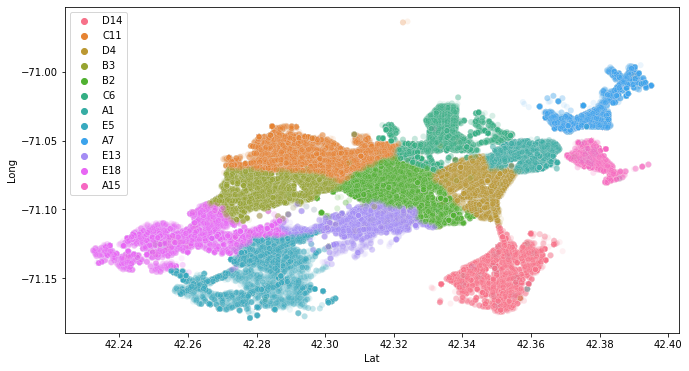

In [55]:
plt.subplots(figsize=(11,6))
sns.scatterplot(x='Lat',
                y='Long',
                hue='DISTRICT',
                alpha=0.1,
                data=crime_df)
plt.legend(loc=2)

**Spatial Scatter Plot Based on Each OFFENSE CODE**

In [58]:
crime_loc = pd.DataFrame(data =(crime_df.groupby(['DISTRICT',"Lat","Long","OFFENSE_CODE_GROUP"]).count()[['INCIDENT_NUMBER']]).reset_index().values,columns=['DISTRICT',"Lat","Long","OFFENSE_CODE_GROUP","CRIME COUNT"])
fig = px.scatter(crime_loc[crime_loc['Lat']!=-1], x="Lat", y="Long", animation_frame="OFFENSE_CODE_GROUP", animation_group="CRIME COUNT",
            color="DISTRICT",width=800, height=500)

fig["layout"].pop("updatemenus") 
fig.show()

**Distribution of Each OFFENSE CODE Across Boston City**

In [59]:
crime_loc[crime_loc['Long']!=-1][crime_loc['Lat']!=-1]

,DISTRICT,Lat,Long,OFFENSE_CODE_GROUP,CRIME COUNT
0,A1,42.250601,-71.132542,Medical Assistance,1
1,A1,42.250601,-71.132542,Violations,1
2,A1,42.254445,-71.122428,Medical Assistance,1
3,A1,42.255173,-71.123313,Fraud,1
4,A1,42.267124,-71.108049,Investigate Person,1
...,...,...,...,...,...
117845,E5,42.356024,-71.061776,Larceny,4
117846,E5,42.356024,-71.061776,Missing Person Located,1
117847,E5,42.356024,-71.061776,Vandalism,1
117848,E5,42.359344,-71.153898,Other,1


In [60]:
fig = px.scatter(crime_loc[crime_loc['Long']!=-1][crime_loc['Lat']!=-1], x="Lat", y="Long",color ='DISTRICT', facet_col="OFFENSE_CODE_GROUP", facet_col_wrap=10,
              facet_row_spacing=0.05, 
              facet_col_spacing=0.05, 
              height=950, width=1800,
              title="Distributions of offences Over City")
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.update_xaxes(range=[42.25, 42.4])
fig.update_yaxes(range = [-71.2, -71])
fig.show()

**PyPlot HeatMap for Crime Distribution**

In [62]:
location = pd.DataFrame(data =(crime_df.groupby(["Lat","Long"]).count()[['INCIDENT_NUMBER']]).reset_index().values, columns=["Lat","Long","CRIME COUNT"])
x,y = location['Long'], location['Lat']
fig = px.density_mapbox(location,lat="Lat",lon="Long",z="CRIME COUNT",radius=10,center=dict(lat=42.357791, lon=-71),zoom = 10,mapbox_style="stamen-terrain",height=500,width=800)
fig.show()

In [66]:
crime_df2 = pd.read_csv('CrimeData/crime.csv',encoding='latin-1')

tmp = crime_df2.groupby('INCIDENT_NUMBER')['YEAR'].count().sort_values(ascending = False)
tmp = pd.DataFrame({'INCIDENT_NUMBER': tmp.index, 'NUM_RECORDS': tmp.values})
seriousCrimes = crime_df.merge(tmp[tmp['NUM_RECORDS'] > 2 ], on = 'INCIDENT_NUMBER', how = 'inner')
seriousCrimes = seriousCrimes[['Lat','Long','OFFENSE_CODE_GROUP']].dropna()

**Folium Cluster Map for Crime Distribution**

In [67]:
from folium.plugins import MarkerCluster
import folium.plugins as plugins
f = folium.Figure(width=800, height=500)
boston_map = folium.Map(location = [seriousCrimes['Lat'].mean(), 
                                  seriousCrimes['Long'].mean()], 
                      zoom_start = 11).add_to(f)

incidents=folium.map.FeatureGroup()
#creating a Marker for each point. 
incidents2=plugins.MarkerCluster().add_to(boston_map)
for lat,lon,label in zip(seriousCrimes.Lat,seriousCrimes.Long,seriousCrimes.OFFENSE_CODE_GROUP):
    folium.Marker(location=[lat,lon],icon=None,popup=label).add_to(incidents2)

boston_map.add_child(incidents2)

boston_map

In [73]:
crime_df3 = pd.read_csv("CrimeData/crime.csv", encoding='latin-1')

crime_df3.dropna(subset=['Lat', 'Long', 'DISTRICT'], inplace=True)

crime_df3 = crime_df3[crime_df3.OFFENSE_CODE_GROUP.isin([
    'Larceny', 'Auto Theft', 'Robbery', 'Larceny From Motor Vehicle', 'Residential Burglary',
    'Simple Assault', 'Harassment', 'Ballistics', 'Aggravated Assault', 'Other Burglary', 
    'Arson', 'Commercial Burglary', 'HOME INVASION', 'Homicide', 'Criminal Harassment', 
    'Manslaughter'])]
crime_df3 = crime_df3[crime_df3.YEAR>=2018]

crime_df3.head()

,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,UCR_PART,STREET,Lat,Long,Location
0,I182070945,619,Larceny,LARCENY ALL OTHERS,D14,808,NaN,2018-09-02 13:00:00,2018,9,Sunday,13,Part One,LINCOLN ST,42.357791,-71.139371,"(42.35779134, -71.13937053)"
6,I182070933,724,Auto Theft,AUTO THEFT,B2,330,NaN,2018-09-03 21:25:00,2018,9,Monday,21,Part One,NORMANDY ST,42.306072,-71.082733,"(42.30607218, -71.08273260)"
8,I182070931,301,Robbery,ROBBERY - STREET,C6,177,NaN,2018-09-03 20:48:00,2018,9,Monday,20,Part One,MASSACHUSETTS AVE,42.331521,-71.070853,"(42.33152148, -71.07085307)"
19,I182070915,614,Larceny From Motor Vehicle,LARCENY THEFT FROM MV - NON-ACCESSORY,B2,181,NaN,2018-09-02 18:00:00,2018,9,Sunday,18,Part One,SHIRLEY ST,42.325695,-71.068168,"(42.32569490, -71.06816778)"
24,I182070908,522,Residential Burglary,BURGLARY - RESIDENTIAL - NO FORCE,B2,911,NaN,2018-09-03 18:38:00,2018,9,Monday,18,Part One,ANNUNCIATION RD,42.335062,-71.093168,"(42.33506218, -71.09316781)"


**Folium Heat Map for Crime Distribution**

In [91]:
from folium.plugins import HeatMap
fig = folium.Map(location=[42.32,-71.0589], tiles='cartodbpositron', zoom_start=10)
HeatMap(data=crime_df3[['Lat', 'Long']], radius=10).add_to(fig)
fig

**Folium Bubble Map for Crime Distribution**

In [96]:
from folium import Choropleth, Circle, Marker

daytime_robberies = crime_df3[((crime_df3.OFFENSE_CODE_GROUP == 'Robbery') & 
                            (crime_df3.HOUR.isin(range(7,23))))]

m_4 = folium.Map(location=[42.32,-71.0589], tiles="cartodbpositron",zoom_start=15)
def color_val(val):
    return 'forestgreen' if (val<=12)  else "darkred" 
    
for i in range(0,len(daytime_robberies)):
    Circle(
        location=[daytime_robberies.iloc[i]['Lat'], daytime_robberies.iloc[i]['Long']],
        radius=40,
        color=color_val(daytime_robberies.iloc[i]['HOUR'])).add_to(m_4)
m_4